In [1]:
# Load paths for using psana
%env SIT_ROOT=/reg/g/psdm/
%env SIT_DATA=/cds/group/psdm/data/
%env SIT_PSDM_DATA=/cds/data/psdm/

env: SIT_ROOT=/reg/g/psdm/
env: SIT_DATA=/cds/group/psdm/data/
env: SIT_PSDM_DATA=/cds/data/psdm/


In [2]:
import matplotlib.pyplot       as plt
import matplotlib.colors       as mcolors
import matplotlib.patches      as mpatches
import matplotlib.transforms   as mtransforms
import matplotlib.font_manager as font_manager
%matplotlib inline

In [3]:
import os
import h5py
import numpy as np

In [4]:
from scipy.spatial.distance import cdist
from scipy.optimize import linear_sum_assignment

In [5]:
# path_cxi_for_pyalgo = "mfxx49820/cwang31/psocake/r0107/mfxx49820_0107_t01.aggregated.cxi"

path_cxi_for_pyalgo = "cxic00318.aggregated.cxi"

In [6]:
# path_cxi_for_peaknet = "inference_results/peaknet.mfxx49820_0107.v2.cxi"
path_cxi_for_peaknet = "inference_results/peaknet.cxic00318_0123.cxi"

In [7]:
try:
    fh_pyalgo.close()
    fh_peaknet.close()
except:
    pass

fh_pyalgo  = h5py.File(path_cxi_for_pyalgo, "r")
fh_peaknet = h5py.File(path_cxi_for_peaknet, "r")

In [8]:
fh_pyalgo.keys()

<KeysViewHDF5 ['entry_1']>

In [9]:
fh_peaknet.get('entry_1/result_1').keys()

<KeysViewHDF5 ['nPeaks', 'nPeaksAll', 'peakEvent', 'peakTotalIntensity', 'peakXPosRaw', 'peakXPosRawAll', 'peakYPosRaw', 'peakYPosRawAll']>

In [10]:
fh_pyalgo.get('entry_1/result_1').keys()

<KeysViewHDF5 ['nPeaksAll', 'peakXPosRawAll', 'peakYPosRawAll']>

In [11]:
n_peaks_pyalgo  = fh_pyalgo.get('entry_1/result_1/nPeaksAll')[:]
n_peaks_peaknet = fh_peaknet.get('entry_1/result_1/nPeaksAll')[:]

In [12]:
min_n_peaks = 10
n_peaks_pyalgo = { enum_idx : n for enum_idx, n in enumerate(n_peaks_pyalgo) if n >= min_n_peaks }

In [13]:
min_n_peaks = 10
n_peaks_peaknet = { enum_idx : n for enum_idx, n in enumerate(n_peaks_peaknet) if n >= min_n_peaks }

In [14]:
len(n_peaks_peaknet), len(n_peaks_pyalgo)

(162679, 103468)

In [15]:
common_events = set([event for event in n_peaks_peaknet.keys()]) & set([event for event in n_peaks_pyalgo.keys()])

In [16]:
# event = 810

# peaks_y_by_pyalgo = fh_pyalgo.get('entry_1/result_1/peakYPosRawAll')[event][:n_peaks_pyalgo[event]]
# peaks_x_by_pyalgo = fh_pyalgo.get('entry_1/result_1/peakXPosRawAll')[event][:n_peaks_pyalgo[event]]

# peaks_y_by_peaknet = fh_peaknet.get('entry_1/result_1/peakYPosRawAll')[event][:n_peaks_peaknet[event]]
# peaks_x_by_peaknet = fh_peaknet.get('entry_1/result_1/peakXPosRawAll')[event][:n_peaks_peaknet[event]]

In [17]:
# peaks_by_pyalgo = [ (y, x) for y, x in zip(peaks_y_by_pyalgo, peaks_x_by_pyalgo) ]
# peaks_by_peaknet = [ (y, x) for y, x in zip(peaks_y_by_peaknet, peaks_x_by_peaknet) ]

In [18]:
# # Assume coords_a and coords_b are your two lists of coordinates
# coords_a = np.array(peaks_by_pyalgo)
# # coords_b = np.array([ (y, x) for y, x in assemble_peak_pos_predicted_list ])
# coords_b = np.array(peaks_by_peaknet)

# # Compute a cost matrix.
# cost_matrix = cdist(coords_a, coords_b)

# # Use linear_sum_assignment to find the optimal assignment.
# row_ind, col_ind = linear_sum_assignment(cost_matrix)

# # Filter assignments based on some threshold distance.
# # threshold_distance = np.inf
# threshold_distance = 5
# close_pairs = [(i, j) for i, j in zip(row_ind, col_ind) if cost_matrix[i, j] <= threshold_distance]

# # Create a new figure
# scale = 2
# ncols = 1
# nrows = 1
# fig   = plt.figure(figsize = (8*scale,20*scale))
# gspec = fig.add_gridspec( nrows, ncols,
#                           width_ratios  = [1],
#                           height_ratios = [1,], 
#                         )
# ax_list = [ fig.add_subplot(gspec[0, 0], aspect = 1), ]

# # Plot image
# ax = ax_list[0]
# # data = img
# # vmin = np.mean(data) - 1 * data.std()
# # vmax = np.mean(data) + 6 * data.std()
# # im = ax.imshow(data, vmin = vmin, vmax = vmax)

# # Plot all points from both sets.
# ax.scatter(coords_a[:, 1], coords_a[:, 0], s = 50, edgecolors='blue', facecolors='none', linewidths=1.0, label='psocake', marker = 's')
# ax.scatter(coords_b[:, 1], coords_b[:, 0], s = 40, edgecolors='red', facecolors='none', linewidths=1, label='peaknet')

# # # Label each dot
# # for i, txt in enumerate(coords_a):
# #     ax.annotate(f's-{i}', (coords_a[i, 1], coords_a[i, 0]), textcoords="offset points", xytext=(25, 5), ha='right')

# # for i, txt in enumerate(coords_b):
# #     ax.annotate(f'o-{i}', (coords_b[i, 1], coords_b[i, 0]), textcoords="offset points", xytext=(25,-5), ha='right')


# # Draw lines between matched points.
# for i, j in close_pairs:
#     ax.plot([coords_a[i, 1], coords_b[j, 1]], [coords_a[i, 0], coords_b[j, 0]], '-x', color='black', linewidth = 1, alpha = 1)
#     # ax.scatter(coords_a[:, 1], coords_a[:, 0], s = 50, edgecolors='blue', facecolors='none', linewidths=1.0, label='psocake', marker = 's')

# # Add labels and legend.
# ax.set_xlabel('X-coordinate')
# ax.set_ylabel('Y-coordinate')
# ax.legend()
# ax.grid(True)
# ax.invert_yaxis()
# # ax.set_xlim(0, 1700)
# # ax.set_ylim(0, 1700)

In [19]:
# match_rate_pyalgo = len(close_pairs) / len(peaks_by_pyalgo)
# match_rate_peaknet = len(close_pairs) / len(peaks_by_peaknet)

In [20]:
# match_rate_pyalgo, match_rate_peaknet

In [26]:
print(len(common_events))

101179


In [21]:
match_rate_pyalgo_dict = {}
match_rate_peaknet_dict = {}

n_peaks_pyalgo_dict = {}
n_peaks_peaknet_dict = {}

threshold_distance = 5
for event in common_events:
    peaks_y_by_pyalgo = fh_pyalgo.get('entry_1/result_1/peakYPosRawAll')[event][:n_peaks_pyalgo[event]]
    peaks_x_by_pyalgo = fh_pyalgo.get('entry_1/result_1/peakXPosRawAll')[event][:n_peaks_pyalgo[event]]

    peaks_y_by_peaknet = fh_peaknet.get('entry_1/result_1/peakYPosRawAll')[event][:n_peaks_peaknet[event]]
    peaks_x_by_peaknet = fh_peaknet.get('entry_1/result_1/peakXPosRawAll')[event][:n_peaks_peaknet[event]]

    peaks_by_pyalgo  = [ (y, x) for y, x in zip(peaks_y_by_pyalgo, peaks_x_by_pyalgo) ]
    peaks_by_peaknet = [ (y, x) for y, x in zip(peaks_y_by_peaknet, peaks_x_by_peaknet) ]

    # Assume coords_a and coords_b are your two lists of coordinates
    coords_a = np.array(peaks_by_pyalgo)
    # coords_b = np.array([ (y, x) for y, x in assemble_peak_pos_predicted_list ])
    coords_b = np.array(peaks_by_peaknet)

    # Compute a cost matrix.
    cost_matrix = cdist(coords_a, coords_b)

    # Use linear_sum_assignment to find the optimal assignment.
    row_ind, col_ind = linear_sum_assignment(cost_matrix)

    # Filter assignments based on some threshold distance.
    close_pairs = [(i, j) for i, j in zip(row_ind, col_ind) if cost_matrix[i, j] <= threshold_distance]

    match_rate_pyalgo  = len(close_pairs) / len(peaks_by_pyalgo)
    match_rate_peaknet = len(close_pairs) / len(peaks_by_peaknet)

    match_rate_pyalgo_dict[event] = match_rate_pyalgo
    match_rate_peaknet_dict[event] = match_rate_peaknet

    n_peaks_pyalgo_dict[event]  = len(peaks_by_pyalgo)
    n_peaks_peaknet_dict[event] = len(peaks_by_peaknet)

In [22]:
# fig = plt.figure(figsize = (12, 12))
# match_rates_pyalgo  = list(match_rate_pyalgo_dict.values())
# match_rates_peaknet = list(match_rate_peaknet_dict.values())
# plt.scatter(match_rates_pyalgo, match_rates_peaknet, )
# plt.xlabel("pyalgo")
# plt.ylabel("peaknet")
# plt.xlim(0, 1)
# plt.ylim(0, 1)

In [23]:
# from bokeh.plotting import figure, show, output_file
# from bokeh.models import HoverTool, ColumnDataSource, Span
# from bokeh.io import output_notebook

# # Prepare the data
# match_rates_pyalgo  = list(match_rate_pyalgo_dict.values())
# match_rates_peaknet = list(match_rate_peaknet_dict.values())
# labels = [ (f"event {event:06d}, pyalgo:{m_pyalgo:.2f}, peaknet:{m_peaknet:.2f}") for event, m_pyalgo, m_peaknet in zip(match_rate_pyalgo_dict.keys(), match_rate_pyalgo_dict.values(), match_rate_peaknet_dict.values()) ]

# # Prepare the data as a dictionary
# source_data = {
#     'x_values': match_rates_pyalgo,
#     'y_values': match_rates_peaknet,
#     'labels': labels
# }

# # Convert dictionary to a ColumnDataSource object
# source = ColumnDataSource(data=source_data)

# # Output to notebook
# output_notebook()

# # Create a new plot with a title and axis labels
# p = figure(title="Matching rate comparison", x_axis_label='pyalgo', y_axis_label='peaknet', x_range=(0, 1), y_range=(0, 1), match_aspect=True)

# # Add a scatter renderer with circle glyphs
# scatter = p.scatter('x_values', 'y_values', size=10, fill_color="blue", line_color="blue", fill_alpha=0.5, source=source)

# # Create a HoverTool object and define the content of the tooltips
# hover = HoverTool(tooltips=[('Label', '@labels')])

# # Add spans for the lines at 0.5 in both directions
# hline = Span(location=0.5, dimension='width', line_color='red', line_width=2)
# vline = Span(location=0.5, dimension='height', line_color='red', line_width=2)
# p.renderers.extend([hline, vline])

# # Add the HoverTool to the figure
# p.add_tools(hover)

# # Show the results
# show(p)

In [24]:
# from bokeh.plotting import figure, show, output_file
# from bokeh.models import HoverTool, ColumnDataSource, Span
# from bokeh.io import output_notebook

# # Prepare the data
# labels = [ (f"event {event:06d}, pyalgo:{m_pyalgo:.2f}, peaknet:{m_peaknet:.2f}") for event, m_pyalgo, m_peaknet in zip(n_peaks_pyalgo_dict.keys(), n_peaks_pyalgo_dict.values(), n_peaks_peaknet_dict.values()) ]

# # Prepare the data as a dictionary
# source_data = {
#     'x_values': list(n_peaks_pyalgo_dict.values()),
#     'y_values': list(n_peaks_peaknet_dict.values()),
#     'labels': labels
# }

# # Convert dictionary to a ColumnDataSource object
# source = ColumnDataSource(data=source_data)

# # Output to notebook
# output_notebook()

# # Create a new plot with a title and axis labels
# p = figure(title="Number of peaks comparison", x_axis_label='pyalgo', y_axis_label='peaknet', match_aspect=True)

# # Add a scatter renderer with circle glyphs
# scatter = p.scatter('x_values', 'y_values', size=10, fill_color="blue", line_color="blue", fill_alpha=0.5, source=source)

# # Create a HoverTool object and define the content of the tooltips
# hover = HoverTool(tooltips=[('Label', '@labels')])

# # # Add spans for the lines at 0.5 in both directions
# # hline = Span(location=0.5, dimension='width', line_color='red', line_width=2)
# # vline = Span(location=0.5, dimension='height', line_color='red', line_width=2)
# # p.renderers.extend([hline, vline])

# # Add the HoverTool to the figure
# p.add_tools(hover)

# # Show the results
# show(p)

In [28]:
from bokeh.layouts import gridplot
from bokeh.plotting import figure, show, output_notebook
from bokeh.models import HoverTool, ColumnDataSource, CustomJS, Span

output_notebook()

# Prepare the data for the first plot (make sure your 'event' is unique)
source_data_1 = {
    'events': list(n_peaks_pyalgo_dict.keys()),
    'x_values': list(n_peaks_pyalgo_dict.values()),
    'y_values': list(n_peaks_peaknet_dict.values()),
    'labels': [f"event {event:06d}, pyalgo:{m_pyalgo:.2f}, peaknet:{m_peaknet:.2f}" 
               for event, m_pyalgo, m_peaknet in zip(n_peaks_pyalgo_dict.keys(), n_peaks_pyalgo_dict.values(), n_peaks_peaknet_dict.values())]
}

# Prepare the data for the second plot
source_data_2 = {
    'events': list(match_rate_pyalgo_dict.keys()),
    'x_values': list(match_rate_pyalgo_dict.values()),
    'y_values': list(match_rate_peaknet_dict.values()),
    'labels': [f"event {event:06d}, pyalgo:{m_pyalgo:.2f}, peaknet:{m_peaknet:.2f}" 
               for event, m_pyalgo, m_peaknet in zip(match_rate_pyalgo_dict.keys(), match_rate_pyalgo_dict.values(), match_rate_peaknet_dict.values())]
}

# Add an 'alphas' field to your data for opacity
source_data_1['alphas'] = [0.9] * len(source_data_1['x_values'])
source_data_2['alphas'] = [0.9] * len(source_data_2['x_values'])

source_data_1['line_alphas'] = [0.9] * len(source_data_1['x_values'])
source_data_2['line_alphas'] = [0.9] * len(source_data_2['x_values'])

# Create the ColumnDataSource objects for both plots
source_1 = ColumnDataSource(data=source_data_1)
source_2 = ColumnDataSource(data=source_data_2)

# Define a CustomJS callback
callback = CustomJS(args=dict(source1=source_1, source2=source_2), code="""
    // Get the data from both sources
    const data1 = source1.data;
    const data2 = source2.data;
    
    // Determine the event that was hovered over
    const hovered_event = cb_data.index.indices[0];
    const event_name = data1.events[hovered_event];
    
    // Define the normal and muted opacities
    const normal_opacity = 1;
    const muted_opacity = 0.2;
    
    // Update the opacities for source 1
    for (let i = 0; i < data1.events.length; i++) {
        if (data1.events[i] !== event_name) {
            data1.alphas[i] = muted_opacity;
        } else {
            data1.alphas[i] = normal_opacity;
        }
    }
    
    // Update the opacities for source 2
    for (let i = 0; i < data2.events.length; i++) {
        if (data2.events[i] !== event_name) {
            data2.alphas[i] = muted_opacity;
        } else {
            data2.alphas[i] = normal_opacity;
        }
    }

    // Update the opacities for source 1
    for (let i = 0; i < data1.events.length; i++) {
        if (data1.events[i] !== event_name) {
            data1.alphas[i] = muted_opacity;
            data1.line_alphas[i] = muted_opacity; // Add this line
        } else {
            data1.alphas[i] = normal_opacity;
            data1.line_alphas[i] = normal_opacity; // And this line
        }
    }

    // Update the opacities for source 2
    for (let i = 0; i < data2.events.length; i++) {
        if (data2.events[i] !== event_name) {
            data2.alphas[i] = muted_opacity;
            data2.line_alphas[i] = muted_opacity; // Add this line
        } else {
            data2.alphas[i] = normal_opacity;
            data2.line_alphas[i] = normal_opacity; // And this line
        }
    }
    
    // Trigger the changes
    source1.change.emit();
    source2.change.emit();
""")

# Create the hover tool and add the callback
hover_1 = HoverTool(tooltips=[('Label', '@labels')], callback=callback, mode='mouse')
hover_2 = HoverTool(tooltips=[('Label', '@labels')], callback=callback, mode='mouse')

# Create the first plot
p1 = figure(title="Number of peaks comparison", x_axis_label='pyalgo', y_axis_label='peaknet', match_aspect=True)
p1.scatter('x_values', 'y_values', size=10, fill_color="blue", line_color="blue", fill_alpha='alphas', line_alpha = 'line_alphas', source=source_1)
p1.add_tools(hover_1)

# Create the second plot
p2 = figure(title="Matching rate comparison", x_axis_label='pyalgo', y_axis_label='peaknet', match_aspect=True)
p2.scatter('x_values', 'y_values', size=10, fill_color="red", line_color="red", fill_alpha='alphas', line_alpha = 'line_alphas', source=source_2)
p2.add_tools(hover_2)

# Add spans for the lines at 0.5 in both directions
hline = Span(location=0.5, dimension='width', line_color='black', line_width=1)
vline = Span(location=0.5, dimension='height', line_color='black', line_width=1)
p2.renderers.extend([hline, vline])

# Add an 'alphas' field to your ColumnDataSource data for opacity
source_data_1['alphas'] = [0.9] * len(source_data_1['x_values'])
source_data_2['alphas'] = [0.9] * len(source_data_2['x_values'])

# Link the callback to the hover tools
hover_1.callback = callback
hover_2.callback = callback

# Create a grid layout
layout = gridplot([[p1, p2]])

show(layout)


Loading BokehJS ...

In [ ]:
match_rate_pyalgo_dict[21349], match_rate_peaknet_dict[21349]

(0.6666666666666666, 0.5555555555555556)

In [ ]:
ColumnDataSource

In [ ]:
import sys; sys.exit(0)

SystemExit: 0

/cds/sw/package/conda_envs/cwang31/peaknet-1.0/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3560: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


In [ ]:
print(fh_pyalgo.get('entry_1/data_1/data').shape)
print(fh_peaknet.get('entry_1/data_1/data').shape)

(40357, 5632, 384)
(1784, 5632, 384)


In [ ]:
print(fh_pyalgo.get('entry_1/result_1/peakXPosRaw').shape)
print(fh_peaknet.get('entry_1/result_1/peakXPosRaw').shape)

(40357, 2048)
(1784, 2048)


In [ ]:
idx = 2
cheetah_img = fh.get('entry_1/data_1/data')[idx]

In [ ]:
x_asmb = fh.get('entry_1/result_1/peakXPosRaw')[idx]
y_asmb = fh.get('entry_1/result_1/peakYPosRaw')[idx]
n_peaks = fh.get('entry_1/result_1/nPeaks')[idx]
event = fh.get('entry_1/result_1/peakEvent')[idx]

In [ ]:
n_peaks, event

(47, 426)

In [ ]:
y_asmb.max(), x_asmb.max()

(5366.0, 370.0)

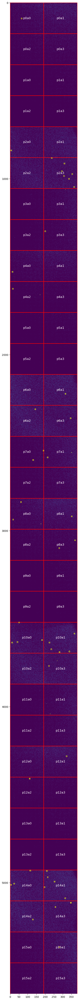

In [ ]:
ncols = 1
nrows = 1
fig   = plt.figure(figsize = (14,14 * 5))
gspec = fig.add_gridspec( nrows, ncols,
                          #width_ratios  = [1/2, 1/2, 1/2, 1/2, 1/2, 1/2, 1/20],
                          #height_ratios = [1/2, 1/2],
                        )
ax_list = [ fig.add_subplot(gspec[i, j], aspect = 1) for i in range(nrows) for j in range(ncols)]    # Plain list
## ax_list = [ [fig.add_subplot(gspec[i, j], aspect = 1) for j in range(ncols) ] for i in range(nrows)  ]    # Nested lists

ax = ax_list[0]
vmin = cheetah_img.mean()
vmax = cheetah_img.mean() + 6 * cheetah_img.std()
ax.imshow(cheetah_img, vmin = vmin, vmax = vmax)


# Apply style...
for ax in ax_list:
    # ax.set_xticks([])
    # ax.set_yticks([])

    # Hide the frame box
    ax.spines['top'   ].set_visible(False)
    ax.spines['right' ].set_visible(False)
    ax.spines['left'  ].set_visible(False)
    ax.spines['bottom'].set_visible(False)

    # Overlay panel label...
    for enum_idx, (k, (x_min, y_min, x_max, y_max)) in enumerate(cheetah_geom_dict.items()):
        x_mean, y_mean = np.mean([x_min, x_max]), np.mean([y_min, y_max])
        ax.scatter(x_mean, y_mean, c = 'black', s=1, alpha = 0)
        rec_obj = mpatches.Rectangle((x_min, y_min),
                                     x_max - x_min, y_max - y_min, 
                                     linewidth = 1.0, 
                                     edgecolor = 'red', 
                                     facecolor='none')
        ax.add_patch(rec_obj)
        ax.text(x_mean, y_mean, k, fontsize=12, c = 'white', ha='center', va='center')
    
    # Place a box on a peak
    offset = 3
    b_offset = 2
    for i in range(n_peaks):
        y = y_asmb[i]
        x = x_asmb[i]
        x_bottom_left = x - offset
        y_bottom_left = y - offset

        rec_obj = mpatches.Rectangle((x_bottom_left, y_bottom_left),
                                    2 * offset, 2 * offset, 
                                    linewidth = 1.0, 
                                    edgecolor = 'yellow', 
                                    facecolor='none')
        ax.add_patch(rec_obj)

    # y_bmin, x_bmin = 0, 0
    # y_bmax, x_bmax = size_y, size_x
    # ax.set_xlim([x_bmin - b_offset, x_bmax + b_offset])
    # ax.set_ylim([y_bmin - b_offset, y_bmax + b_offset])
    # ax.invert_yaxis()

In [ ]:
import sys; sys.exit(0)

SystemExit: 0

In [ ]:
fh.close()

In [ ]:
from peaknet.plugins  import PsanaImg, Psana2Cheetah, apply_mask

exp           = 'mfxx49820'
run           = 107
img_load_mode = 'calib'
access_mode   = 'idx'
detector_name = 'MfxEndstation.0:Epix10ka2M.0'

psana_img = PsanaImg(exp, run, access_mode, detector_name)
mask_bad_pixel = psana_img.create_bad_pixel_mask()

In [ ]:
idx = 810
idx = 185
img = psana_img.get(idx, None, 'calib')
img = apply_mask(img, mask_bad_pixel, mask_value = 0)

In [ ]:
img.shape

(16, 352, 384)

In [ ]:
# cheetah2psana_geom_dict

In [ ]:
p2c = Psana2Cheetah('cheetah_geom.epix10k2M.pickle')

In [ ]:
cheetah_img = p2c.convert_to_cheetah_img(img)

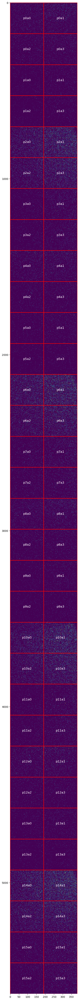

In [ ]:
ncols = 1
nrows = 1
fig   = plt.figure(figsize = (14,14 * 5))
gspec = fig.add_gridspec( nrows, ncols,
                          #width_ratios  = [1/2, 1/2, 1/2, 1/2, 1/2, 1/2, 1/20],
                          #height_ratios = [1/2, 1/2],
                        )
ax_list = [ fig.add_subplot(gspec[i, j], aspect = 1) for i in range(nrows) for j in range(ncols)]    # Plain list
## ax_list = [ [fig.add_subplot(gspec[i, j], aspect = 1) for j in range(ncols) ] for i in range(nrows)  ]    # Nested lists

ax = ax_list[0]
vmin = cheetah_img.mean()
vmax = cheetah_img.mean() + 6 * cheetah_img.std()
ax.imshow(cheetah_img, vmin = vmin, vmax = vmax)


# Apply style...
for ax in ax_list:
    # ax.set_xticks([])
    # ax.set_yticks([])

    # Hide the frame box
    ax.spines['top'   ].set_visible(False)
    ax.spines['right' ].set_visible(False)
    ax.spines['left'  ].set_visible(False)
    ax.spines['bottom'].set_visible(False)

    # Overlay panel label...
    for enum_idx, (k, (x_min, y_min, x_max, y_max)) in enumerate(cheetah_geom_dict.items()):
        x_mean, y_mean = np.mean([x_min, x_max]), np.mean([y_min, y_max])
        ax.scatter(x_mean, y_mean, c = 'black', s=1, alpha = 0)
        rec_obj = mpatches.Rectangle((x_min, y_min),
                                     x_max - x_min, y_max - y_min, 
                                     linewidth = 1.0, 
                                     edgecolor = 'red', 
                                     facecolor='none')
        ax.add_patch(rec_obj)
        ax.text(x_mean, y_mean, k, fontsize=12, c = 'white', ha='center', va='center')